# Segmenting and Clustering Neighborhoods in New York and Toronto City
        
#### Applied Data Science Capstone Week 5 Peer-Graded Assignment

<h1 align=center><font size = 5>  New York City - Montage</font></h1>

![alt text](https://upload.wikimedia.org/wikipedia/commons/thumb/9/9d/NYC_Montage_2014_4_-_Jleon.jpg/305px-NYC_Montage_2014_4_-_Jleon.jpg "NYC")


<h1 align=center><font size = 5>Toronto City - Skyline</font></h1>

![alt text](https://www.toronto.ca/wp-content/uploads/2017/07/9163-invest-in-toronto-995x330.png "Toronto City")

## Table of contents

* [Introduction](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)

## Introduction  <a name="introduction"></a>

In this Exercise, I would like to leverage the course exercises on examining the neighborhoods in NY and Toronto City. Compare the two Metropolises and understanding how similar or different they are in terms of 

1. What type of Venues are Common or Different
2. Which venue is suitable for a new restuarant to be opened
3. Diversity of each city in terms of top venues and clusters by Venues
4. Finally I would also like to present an analysis of Crime - Field reports in both these cities.

## Data  <a name="data"></a>

We need Data for with Latitude and Longitude cordinates for the neighbourhoods in the two cities along with datasets recording the crime details in both New York and Toronto.


* New York Neighborhood Dataset: https://cocl.us/new_york_dataset

* New York Crime Data: https://data.cityofnewyork.us/Public-Safety/NYPD-Complaint-Data-Historic/qgea-i56i

* Toronto Neighborhood Data: scraped from https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M using BeautifulSoup

* Toronto Crime Data: http://data.torontopolice.on.ca/datasets/mci-2014-to-2018/data (Only the crimes reported in the year 2018 is considered for this analysis)

## Methodology  <a name="methodology"></a>

The addresses will be converted into their equivalent latitude and longitude values. Using the Foursquare API we can explore neighborhoods in New York and Toronto Cities. We will use the **explore** function to get the most common venue categories in each neighborhood, and then use this feature to group the neighborhoods into clusters. We use the *k*-means clustering algorithm to complete this task. Finally, the Folium library will be applied to visualize the neighborhoods in both the cities and their emerging clusters.

## Analysis <a name="analysis"></a>

We create a visual representation of neighborhoods in New York and Toronto Metropolitan cities first, and then create a subset of Neighborhoods coming within the borough of Manahattan for New York and neighborhood names containg "Toronto" for Toronto City area.

In [1]:
# Importing and installing all the required Libraries

import numpy as np # library to handle data in a vectorized manner
import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

print('Libraries imported.')

Libraries imported.


In [2]:
!curl -0 https://cocl.us/new_york_dataset --output 'newyork_data.json'

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   732    0   732    0     0    585      0 --:--:--  0:00:01 --:--:--   586


In [4]:
with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [5]:
newyork_data

{'type': 'FeatureCollection',
 'totalFeatures': 306,
 'features': [{'type': 'Feature',
   'id': 'nyu_2451_34572.1',
   'geometry': {'type': 'Point',
    'coordinates': [-73.84720052054902, 40.89470517661]},
   'geometry_name': 'geom',
   'properties': {'name': 'Wakefield',
    'stacked': 1,
    'annoline1': 'Wakefield',
    'annoline2': None,
    'annoline3': None,
    'annoangle': 0.0,
    'borough': 'Bronx',
    'bbox': [-73.84720052054902,
     40.89470517661,
     -73.84720052054902,
     40.89470517661]}},
  {'type': 'Feature',
   'id': 'nyu_2451_34572.2',
   'geometry': {'type': 'Point',
    'coordinates': [-73.82993910812398, 40.87429419303012]},
   'geometry_name': 'geom',
   'properties': {'name': 'Co-op City',
    'stacked': 2,
    'annoline1': 'Co-op',
    'annoline2': 'City',
    'annoline3': None,
    'annoangle': 0.0,
    'borough': 'Bronx',
    'bbox': [-73.82993910812398,
     40.87429419303012,
     -73.82993910812398,
     40.87429419303012]}},
  {'type': 'Feature',
 

In [6]:
NY_nhoods_data = newyork_data['features']

In [7]:
NY_nhoods_data[0]

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

#### Tranform the data into a pandas dataframe

In [8]:
# define an empty dataframe with these columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude']

# instantiate the dataframe
NY_nhoods = pd.DataFrame(columns=column_names)

In [9]:
NY_nhoods

,Borough,Neighborhood,Latitude,Longitude


In [10]:
for data in NY_nhoods_data:
    borough = nhood_name = data['properties']['borough'] 
    nhood_name = data['properties']['name']
        
    nhood_latlon = data['geometry']['coordinates']
    nhood_lat = nhood_latlon[1]
    nhood_lon = nhood_latlon[0]
    
    NY_nhoods = NY_nhoods.append({'Borough': borough,
                                          'Neighborhood': nhood_name,
                                          'Latitude': nhood_lat,
                                          'Longitude': nhood_lon}, ignore_index=True)

In [11]:
NY_nhoods.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [12]:
# Making sure that the df has all 5 Boroughs and 306 Neighbourhoods
print('The dataframe has {} boroughs and {} neighborhoods.'.format(
        len(NY_nhoods['Borough'].unique()),
        NY_nhoods.shape[0]
    )
)

The dataframe has 5 boroughs and 306 neighborhoods.


#### Defining an instance of the geocoder, by defining a user_agent. We will name our agent ny_explorer, as shown below.

In [13]:
address = 'New York City, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geographical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geographical coordinate of New York City are 40.7127281, -74.0060152.


In [14]:
# create map of New York using latitude and longitude values
map_ny = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, nhood in zip(NY_nhoods['Latitude'], NY_nhoods['Longitude'],NY_nhoods['Borough'], NY_nhoods['Neighborhood']):
    label = '{}, {}'.format(nhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_ny)  
    
map_ny

In [35]:
#Simplifying the analysis to include Neighborhoods from Manahattan Borough only
manhattan_data = NY_nhoods[NY_nhoods['Borough'] == 'Manhattan'].reset_index(drop=True)
manhattan_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Manhattan,Marble Hill,40.876551,-73.910660
1,Manhattan,Chinatown,40.715618,-73.994279
2,Manhattan,Washington Heights,40.851903,-73.936900
3,Manhattan,Inwood,40.867684,-73.921210
4,Manhattan,Hamilton Heights,40.823604,-73.949688


#### Utilizing the Foursquare API to explore NY neighborhoods and segment them.


Define Foursquare Credentials and Version

In [130]:
# Define Foursquare Credentials and Version, radius of coverage from Neighbor hood and Limit number of venues to 10 per nhood

radius = 300
LIMIT = 50

CLIENT_ID = 'XXXXX' # your Foursquare ID
CLIENT_SECRET = 'XXXX' # your Foursquare Secret
VERSION = '20190524' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XXXXX
CLIENT_SECRET:XXXX


In [36]:
manhattan_data.loc[0, 'Neighborhood']

'Marble Hill'

In [37]:
# Get the neighborhood's latitude and longitude values.
nhood_latitude = manhattan_data.loc[0, 'Latitude'] # neighborhood latitude value
nhood_longitude = manhattan_data.loc[0, 'Longitude'] # neighborhood longitude value
nhood_name = manhattan_data.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(nhood_name, 
                                                               nhood_latitude, 
                                                               nhood_longitude))

Latitude and longitude values of Marble Hill are 40.87655077879964, -73.91065965862981.


### Create a function to gather venue details from Foursquare

In [38]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [39]:
#Running the above function on each neighborhood and create a new dataframe called NY_venues
manhattan_venues = getNearbyVenues(names=manhattan_data['Neighborhood'],
                                   latitudes=manhattan_data['Latitude'],
                                   longitudes=manhattan_data['Longitude']
                                  )

Marble Hill
Chinatown
Washington Heights
Inwood
Hamilton Heights
Manhattanville
Central Harlem
East Harlem
Upper East Side
Yorkville
Lenox Hill
Roosevelt Island
Upper West Side
Lincoln Square
Clinton
Midtown
Murray Hill
Chelsea
Greenwich Village
East Village
Lower East Side
Tribeca
Little Italy
Soho
West Village
Manhattan Valley
Morningside Heights
Gramercy
Battery Park City
Financial District
Carnegie Hill
Noho
Civic Center
Midtown South
Sutton Place
Turtle Bay
Tudor City
Stuyvesant Town
Flatiron
Hudson Yards


In [40]:
# Determine the size of NY Venues df
print(manhattan_venues.shape)
manhattan_venues.head()

(799, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Marble Hill,40.876551,-73.91066,Arturo's,40.874412,-73.910271,Pizza Place
1,Marble Hill,40.876551,-73.91066,Bikram Yoga,40.876844,-73.906204,Yoga Studio
2,Marble Hill,40.876551,-73.91066,Tibbett Diner,40.880404,-73.908937,Diner
3,Marble Hill,40.876551,-73.91066,Dunkin',40.877136,-73.906666,Donut Shop
4,Marble Hill,40.876551,-73.91066,Starbucks,40.877531,-73.905582,Coffee Shop


In [41]:
# Checking how many venues were returned for each neighborhood
manhattan_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Battery Park City,20,20,20,20,20,20
Carnegie Hill,20,20,20,20,20,20
Central Harlem,20,20,20,20,20,20
Chelsea,20,20,20,20,20,20
Chinatown,20,20,20,20,20,20
Civic Center,20,20,20,20,20,20
Clinton,20,20,20,20,20,20
East Harlem,20,20,20,20,20,20
East Village,20,20,20,20,20,20


In [42]:
#unique categories obtained from all the returned venues
print('There are {} uniques categories.'.format(len(manhattan_venues['Venue Category'].unique())))

There are 203 uniques categories.


In [43]:
#Analyze Neighborhoods in Manhattan
# one hot encoding
man_onehot = pd.get_dummies(manhattan_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
man_onehot['Neighborhood'] = manhattan_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [man_onehot.columns[-1]] + list(man_onehot.columns[:-1])
man_onehot = man_onehot[fixed_columns]

man_onehot.head()

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Animal Shelter,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Garden,Beer Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Stop,Café,Candy Store,Caribbean Restaurant,Chinese Restaurant,Chocolate Shop,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,Comedy Club,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dog Run,Donut Shop,Dumpling Restaurant,Duty-free Shop,English Restaurant,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Filipino Restaurant,Fish Market,Food Court,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden Center,Gas Station,Gastropub,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Hawaiian Restaurant,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,New American Restaurant,Newsstand,Nightclub,Noodle House,Opera House,Optical Shop,Other Nightlife,Outdoor Sculpture,Outdoors & Recreation,Park,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Pub,Public Art,Ramen Restaurant,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Rock Club,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Seafood Restaurant,Shanghai Restaurant,Shoe Store,Shopping Mall,Smoke Shop,Snack Place,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Spiritual Center,Sporting Goods Shop,Sports Club,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Stadium,Thai Restaurant,Theater,Tourist Information Center,Toy / Game Store,Trail,Turkish Restaurant,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Waterfront,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,Marble Hill,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Marble Hill,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,Marble Hill,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [44]:
man_onehot.shape

(799, 204)

In [45]:
man_grouped = man_onehot.groupby('Neighborhood').mean().reset_index()
man_grouped

,Neighborhood,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Animal Shelter,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Basketball Court,Beer Bar,Beer Garden,Beer Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Stop,Café,Candy Store,Caribbean Restaurant,Chinese Restaurant,Chocolate Shop,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Academic Building,Comedy Club,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dog Run,Donut Shop,Dumpling Restaurant,Duty-free Shop,English Restaurant,Ethiopian Restaurant,Event Space,Falafel Restaurant,Farmers Market,Filipino Restaurant,Fish Market,Food Court,Food Truck,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden Center,Gas Station,Gastropub,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Hawaiian Restaurant,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Irish Pub,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Library,Lingerie Store,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Molecular Gastronomy Restaurant,Monument / Landmark,Moroccan Restaurant,Movie Theater,Museum,Music School,Music Venue,New American Restaurant,Newsstand,Nightclub,Noodle House,Opera House,Optical Shop,Other Nightlife,Outdoor Sculpture,Outdoors & Recreation,Park,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Pub,Public Art,Ramen Restaurant,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Rock Club,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Seafood Restaurant,Shanghai Restaurant,Shoe Store,Shopping Mall,Smoke Shop,Snack Place,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Spiritual Center,Sporting Goods Shop,Sports Club,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Stadium,Thai Restaurant,Theater,Tourist Information Center,Toy / Game Store,Trail,Turkish Restaurant,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Waterfront,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,Battery Park City,0.00,0.00,0.00,0.00,0.05,0.00,0.00,0.00,0.00,0.00,0.00,0.05,0.00,0.00,0.00,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.05,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.050000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.05,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.1,0.00,0.000000,0.00,0.00,0.00,0.00,0.00,0.000000,0.0,0.00,0.000000,0.00,0.00,0.00,0.00,0.00,0.05,0.00,0.000000,0.00,0.00,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.1,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.150000,0.05,0.00,0.00,0.000000,0.00,0.00,0.00,0.00,0.000000,0.05,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.10,0.05,0.00,0.00,0.00,0.00,0.05,0.05,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.

In [46]:
man_grouped.shape

(40, 204)

In [48]:
num_top_venues = 10

for hood in man_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = man_grouped[man_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Battery Park City----
            venue  freq
0            Park  0.15
1  Sandwich Place  0.10
2      Food Court  0.10
3   Memorial Site  0.10
4      Smoke Shop  0.05
5   Shopping Mall  0.05
6             Gym  0.05
7     Coffee Shop  0.05
8  Scenic Lookout  0.05
9       BBQ Joint  0.05


----Carnegie Hill----
                  venue  freq
0    Italian Restaurant  0.10
1                   Spa  0.10
2                   Gym  0.10
3  Gym / Fitness Center  0.10
4          Dance Studio  0.05
5            Bagel Shop  0.05
6           Pizza Place  0.05
7          Gourmet Shop  0.05
8             Bookstore  0.05
9           Coffee Shop  0.05


----Central Harlem----
                 venue  freq
0  American Restaurant  0.10
1                 Café  0.05
2            Jazz Club  0.05
3       Cosmetics Shop  0.05
4             Beer Bar  0.05
5                  Bar  0.05
6         Cycle Studio  0.05
7          Music Venue  0.05
8    French Restaurant  0.05
9                  Spa  0.05


----Chelse

                 venue  freq
0  American Restaurant  0.15
1            Bookstore  0.15
2           Food Truck  0.10
3                 Park  0.10
4       Farmers Market  0.05
5       Sandwich Place  0.05
6          Coffee Shop  0.05
7                  Pub  0.05
8                 Café  0.05
9       Ice Cream Shop  0.05


----Murray Hill----
                 venue  freq
0                Hotel  0.10
1               Museum  0.05
2       Sandwich Place  0.05
3          Coffee Shop  0.05
4             Tea Room  0.05
5         Cocktail Bar  0.05
6  Hawaiian Restaurant  0.05
7           Restaurant  0.05
8    French Restaurant  0.05
9     Ramen Restaurant  0.05


----Noho----
                             venue  freq
0                     Cocktail Bar  0.10
1                      Coffee Shop  0.10
2               Italian Restaurant  0.10
3                        Rock Club  0.10
4                    Deli / Bodega  0.10
5                French Restaurant  0.10
6                              Gym  0.

In [49]:
# function to sort venues in Desc order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [58]:
#Create new dataframe and display the top 10 venues for each neighborhood.

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
nhoods_venues_sorted = pd.DataFrame(columns=columns)
nhoods_venues_sorted['Neighborhood'] = man_grouped['Neighborhood']

for ind in np.arange(man_grouped.shape[0]):
    nhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(man_grouped.iloc[ind, :], num_top_venues)

nhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Battery Park City,Park,Food Court,Memorial Site,Sandwich Place,Cupcake Shop,BBQ Joint,Performing Arts Venue,Burrito Place,Scenic Lookout,Smoke Shop
1,Carnegie Hill,Italian Restaurant,Spa,Gym,Gym / Fitness Center,Dance Studio,Ramen Restaurant,Gourmet Shop,Coffee Shop,Bagel Shop,Café
2,Central Harlem,American Restaurant,Dessert Shop,Bagel Shop,Café,Spa,Caribbean Restaurant,Music Venue,Library,Ethiopian Restaurant,Beer Bar
3,Chelsea,Theater,Indian Restaurant,Tapas Restaurant,Ice Cream Shop,Italian Restaurant,Gift Shop,French Restaurant,Fish Market,Nightclub,Cupcake Shop
4,Chinatown,Sandwich Place,Noodle House,Spa,Chinese Restaurant,English Restaurant,Tea Room,Garden Center,Salon / Barbershop,Cocktail Bar,Greek Restaurant


In [59]:
# Cluster Neighborhoods

# set number of clusters
kclusters = 5

man_grouped_clustering = man_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(man_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([4, 1, 1, 2, 2, 1, 3, 0, 4, 4], dtype=int32)

In [60]:
# creating a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.
# add clustering labels
nhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

man_merged = manhattan_data

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
man_merged = man_merged.join(nhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

man_merged.head()

,Borough,Neighborhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Manhattan,Marble Hill,40.876551,-73.910660,4,Discount Store,Coffee Shop,Yoga Studio,Tennis Stadium,Ice Cream Shop,Gym,Donut Shop,Diner,Department Store,Pizza Place
1,Manhattan,Chinatown,40.715618,-73.994279,2,Sandwich Place,Noodle House,Spa,Chinese Restaurant,English Restaurant,Tea Room,Garden Center,Salon / Barbershop,Cocktail Bar,Greek Restaurant
2,Manhattan,Washington Heights,40.851903,-73.936900,4,Park,Bakery,Wine Shop,Café,Deli / Bodega,Ramen Restaurant,Cocktail Bar,Restaurant,Burger Joint,Breakfast Spot
3,Manhattan,Inwood,40.867684,-73.921210,4,Café,Wine Bar,Park,Yoga Studio,Bakery,Pet Store,Deli / Bodega,Diner,Coffee Shop,Farmers Market
4,Manhattan,Hamilton Heights,40.823604,-73.949688,2,Yoga Studio,Mexican Restaurant,Caribbean Restaurant,Cocktail Bar,Pub,Food Truck,Mediterranean Restaurant,Café,Coffee Shop,Bar


In [62]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(man_merged['Latitude'], man_merged['Longitude'], man_merged['Neighborhood'], man_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [63]:
# Examining Clusters
man_merged.loc[man_merged['Cluster Labels'] == 0, man_merged.columns[[1] + list(range(5, man_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
7,East Harlem,Mexican Restaurant,Coffee Shop,Spanish Restaurant,French Restaurant,Sandwich Place,Steakhouse,Beer Bar,Donut Shop,Thai Restaurant,Bakery
10,Lenox Hill,Gym,French Restaurant,Thai Restaurant,Pizza Place,Dessert Shop,College Academic Building,Cocktail Bar,Salad Place,Smoke Shop,Middle Eastern Restaurant
34,Sutton Place,Gym,Indian Restaurant,Grocery Store,Steakhouse,Adult Boutique,American Restaurant,Beer Garden,Beer Store,Dessert Shop,Greek Restaurant


In [64]:
man_merged.loc[man_merged['Cluster Labels'] == 1, man_merged.columns[[1] + list(range(5, man_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,Central Harlem,American Restaurant,Dessert Shop,Bagel Shop,Café,Spa,Caribbean Restaurant,Music Venue,Library,Ethiopian Restaurant,Beer Bar
12,Upper West Side,Italian Restaurant,Southern / Soul Food Restaurant,Bagel Shop,Café,Bookstore,Chinese Restaurant,Movie Theater,Gift Shop,Pub,Juice Bar
18,Greenwich Village,Café,French Restaurant,Italian Restaurant,Yoga Studio,Bagel Shop,Food Truck,Caribbean Restaurant,Sushi Restaurant,Beer Bar,Gourmet Shop
21,Tribeca,Park,Wine Shop,American Restaurant,Greek Restaurant,Coffee Shop,Salad Place,Café,Spa,Cycle Studio,Furniture / Home Store
22,Little Italy,Café,Wine Bar,Ice Cream Shop,Sandwich Place,Gourmet Shop,Salad Place,Clothing Store,Salon / Barbershop,Coffee Shop,Newsstand
23,Soho,Men's Store,Yoga Studio,Women's Store,Clothing Store,Tea Room,Dessert Shop,Optical Shop,Salon / Barbershop,Miscellaneous Shop,Boutique
26,Morningside Heights,American Restaurant,Bookstore,Food Truck,Park,Pub,Sandwich Place,Greek Restaurant,Coffee Shop,Café,Farmers Market
27,Gramercy,Pizza Place,Coffee Shop,Spa,Yoga Studio,Beer Bar,Irish Pub,Italian Restaurant,Gourmet Shop,Liquor Store,Mexican Restaurant
30,Carnegie Hill,Italian Restaurant,Spa,Gym,Gym / Fitness Center,Dance Studio,Ramen Restaurant,Gourmet Shop,Coffee Shop,Bagel Shop,Café
32,Civic Center,Bakery,Falafel Restaurant,Yoga Studio,Cuban Restaurant,Park,Sandwich Place,Monument / Landmark,Molecular Gastronomy Restaurant,French Restaurant,Spa


In [65]:
man_merged.loc[man_merged['Cluster Labels'] == 2, man_merged.columns[[1] + list(range(5, man_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Chinatown,Sandwich Place,Noodle House,Spa,Chinese Restaurant,English Restaurant,Tea Room,Garden Center,Salon / Barbershop,Cocktail Bar,Greek Restaurant
4,Hamilton Heights,Yoga Studio,Mexican Restaurant,Caribbean Restaurant,Cocktail Bar,Pub,Food Truck,Mediterranean Restaurant,Café,Coffee Shop,Bar
5,Manhattanville,Italian Restaurant,Indian Restaurant,BBQ Joint,Beer Garden,Sushi Restaurant,Climbing Gym,Mexican Restaurant,Juice Bar,Ramen Restaurant,Coffee Shop
8,Upper East Side,Hotel,Japanese Restaurant,Optical Shop,Coffee Shop,Chocolate Shop,French Restaurant,Café,Burrito Place,Boutique,Bookstore
15,Midtown,Hotel,Spa,Bakery,Smoke Shop,Park,Mediterranean Restaurant,French Restaurant,Sporting Goods Shop,Steakhouse,Salad Place
16,Murray Hill,Hotel,Tea Room,Coffee Shop,Ramen Restaurant,Museum,Sushi Restaurant,Restaurant,Shanghai Restaurant,Cocktail Bar,Jazz Club
17,Chelsea,Theater,Indian Restaurant,Tapas Restaurant,Ice Cream Shop,Italian Restaurant,Gift Shop,French Restaurant,Fish Market,Nightclub,Cupcake Shop
20,Lower East Side,Art Gallery,Cocktail Bar,Coffee Shop,Yoga Studio,Juice Bar,Community Center,Mediterranean Restaurant,Japanese Restaurant,Filipino Restaurant,Italian Restaurant
24,West Village,Cosmetics Shop,Italian Restaurant,Gourmet Shop,Gastropub,Chinese Restaurant,Bakery,Mediterranean Restaurant,Coffee Shop,Candy Store,Boutique
31,Noho,Cocktail Bar,Italian Restaurant,Rock Club,Coffee Shop,French Restaurant,Deli / Bodega,Gourmet Shop,Hotel,Southern / Soul Food Restaurant,Boutique


In [66]:
man_merged.loc[man_merged['Cluster Labels'] == 3, man_merged.columns[[1] + list(range(5, man_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
13,Lincoln Square,Theater,Concert Hall,Indie Movie Theater,Opera House,Performing Arts Venue,Fountain,Indie Theater,Plaza,Gift Shop,Library
14,Clinton,Gym / Fitness Center,Theater,Mediterranean Restaurant,Lounge,Building,Sporting Goods Shop,Comedy Club,Café,French Restaurant,Peruvian Restaurant


In [67]:
man_merged.loc[man_merged['Cluster Labels'] == 4, man_merged.columns[[1] + list(range(5, man_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Marble Hill,Discount Store,Coffee Shop,Yoga Studio,Tennis Stadium,Ice Cream Shop,Gym,Donut Shop,Diner,Department Store,Pizza Place
2,Washington Heights,Park,Bakery,Wine Shop,Café,Deli / Bodega,Ramen Restaurant,Cocktail Bar,Restaurant,Burger Joint,Breakfast Spot
3,Inwood,Café,Wine Bar,Park,Yoga Studio,Bakery,Pet Store,Deli / Bodega,Diner,Coffee Shop,Farmers Market
9,Yorkville,Wine Shop,Deli / Bodega,Coffee Shop,Hobby Shop,Pub,Monument / Landmark,Liquor Store,Sandwich Place,Beer Store,Sushi Restaurant
11,Roosevelt Island,Sandwich Place,Coffee Shop,Park,Liquor Store,Kosher Restaurant,Residential Building (Apartment / Condo),Rental Car Location,Farmers Market,Japanese Restaurant,School
19,East Village,Wine Shop,Coffee Shop,Vietnamese Restaurant,Pizza Place,Hot Dog Joint,Beer Store,Bar,Bagel Shop,Japanese Restaurant,Dog Run
25,Manhattan Valley,Bar,Deli / Bodega,Yoga Studio,Italian Restaurant,Hawaiian Restaurant,Grocery Store,Korean Restaurant,Fried Chicken Joint,Mexican Restaurant,Ethiopian Restaurant
28,Battery Park City,Park,Food Court,Memorial Site,Sandwich Place,Cupcake Shop,BBQ Joint,Performing Arts Venue,Burrito Place,Scenic Lookout,Smoke Shop
29,Financial District,Jewelry Store,Steakhouse,Gym / Fitness Center,Coffee Shop,Accessories Store,Monument / Landmark,Falafel Restaurant,Event Space,Café,New American Restaurant
36,Tudor City,Park,Deli / Bodega,Yoga Studio,Pizza Place,Martial Arts Dojo,Spanish Restaurant,Sushi Restaurant,Taco Place,Coffee Shop,Thai Restaurant


## Analyzing Toronto Neighbourhoods

We scrape postal codes, Borough and Neighbourhood list from the Wikipedia article on Canada Post Codes starting with "M". We then add the geolographical co-ordinates  to the neighbourhoods to visualize them on a map. 

In [75]:
# specify which URL/web page we are going to be scraping
url = "https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M"

In [76]:
# import the BeautifulSoup library so we can parse HTML and XML documents
from bs4 import BeautifulSoup
import xml

In [77]:
source = requests.get('https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M').text
soup = BeautifulSoup(source,'lxml')

In [78]:
# use the 'find_all' function to bring back all instances of the 'table' and 'td' tags in the HTML and store in 'all_tables' and  'fields' variables
all_tables=soup.find('table')
fields = all_tables.find_all('td')

In [79]:
# use tags to find Postcode, Borough and Neighbourhoods
postcode=[]
borough=[]
neighbourhood=[]


for i in range(0, len(fields), 3):
    postcode.append(fields[i].text.strip())
    borough.append(fields[i+1].text.strip())
    neighbourhood.append(fields[i+2].text.strip())

df = pd.DataFrame(data=[postcode, borough, neighbourhood]).transpose()
df.columns = ['Postcode', 'Borough', 'Neighbourhood']

df.head()

,Postcode,Borough,Neighbourhood
0,M1A,Not assigned,Not assigned
1,M2A,Not assigned,Not assigned
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,Harbourfront


In [80]:
# Drop Not assigned and aggregate
df['Borough'].replace('Not assigned', np.nan, inplace=True)
df.dropna(subset=['Borough'], inplace=True)

df.head()

,Postcode,Borough,Neighbourhood
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,Harbourfront
5,M5A,Downtown Toronto,Regent Park
6,M6A,North York,Lawrence Heights


In [81]:
df1 = df.groupby(['Postcode', 'Borough'])['Neighbourhood'].apply(', '.join).reset_index()
df1.columns = ['Postcode', 'Borough', 'Neighbourhood']
df1

,Postcode,Borough,Neighbourhood
0,M1B,Scarborough,"Rouge, Malvern"
1,M1C,Scarborough,"Highland Creek, Rouge Hill, Port Union"
2,M1E,Scarborough,"Guildwood, Morningside, West Hill"
3,M1G,Scarborough,Woburn
4,M1H,Scarborough,Cedarbrae
5,M1J,Scarborough,Scarborough Village
6,M1K,Scarborough,"East Birchmount Park, Ionview, Kennedy Park"
7,M1L,Scarborough,"Clairlea, Golden Mile, Oakridge"
8,M1M,Scarborough,"Cliffcrest, Cliffside, Scarborough Village West"
9,M1N,Scarborough,"Birch Cliff, Cliffside West"


In [82]:
# Replacing 'Not Assigned' in Neighbourhood for Queen's Park
df1['Neighbourhood'].replace('Not assigned', "Queen's Park", inplace=True)
df1

,Postcode,Borough,Neighbourhood
0,M1B,Scarborough,"Rouge, Malvern"
1,M1C,Scarborough,"Highland Creek, Rouge Hill, Port Union"
2,M1E,Scarborough,"Guildwood, Morningside, West Hill"
3,M1G,Scarborough,Woburn
4,M1H,Scarborough,Cedarbrae
5,M1J,Scarborough,Scarborough Village
6,M1K,Scarborough,"East Birchmount Park, Ionview, Kennedy Park"
7,M1L,Scarborough,"Clairlea, Golden Mile, Oakridge"
8,M1M,Scarborough,"Cliffcrest, Cliffside, Scarborough Village West"
9,M1N,Scarborough,"Birch Cliff, Cliffside West"


In [83]:
df_LatLong = pd.read_csv('http://cocl.us/Geospatial_data')
df_LatLong.columns = ['Postcode', 'Latitude', 'Longitude']

In [84]:
df2 = pd.merge(df1, df_LatLong, on=['Postcode'], how='inner')

df_fin = df2[['Postcode', 'Borough', 'Neighbourhood', 'Latitude', 'Longitude']].copy()

df_fin.head()

,Postcode,Borough,Neighbourhood,Latitude,Longitude
0,M1B,Scarborough,"Rouge, Malvern",43.806686,-79.194353
1,M1C,Scarborough,"Highland Creek, Rouge Hill, Port Union",43.784535,-79.160497
2,M1E,Scarborough,"Guildwood, Morningside, West Hill",43.763573,-79.188711
3,M1G,Scarborough,Woburn,43.770992,-79.216917
4,M1H,Scarborough,Cedarbrae,43.773136,-79.239476


In [85]:
address = 'Toronto, Canada'

geolocator = Nominatim(user_agent = "to_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of the City of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of the City of Toronto are 43.653963, -79.387207.


In [86]:
# create map of Toronto using latitude and longitude values
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(df_fin['Latitude'], df_fin['Longitude'], df_fin['Borough'], df_fin['Neighbourhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html = True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#800080',
        fill_opacity=0.5,
        parse_html=False).add_to(map_toronto)  
    
map_toronto

In [87]:
# select only Boroughs with Toronto in thier Name
df_tor = df_fin[df_fin['Borough'].str.contains('Toronto')]

tor_data = df_tor.reset_index(drop=True)
tor_data

,Postcode,Borough,Neighbourhood,Latitude,Longitude
0,M4E,East Toronto,The Beaches,43.676357,-79.293031
1,M4K,East Toronto,"The Danforth West, Riverdale",43.679557,-79.352188
2,M4L,East Toronto,"The Beaches West, India Bazaar",43.668999,-79.315572
3,M4M,East Toronto,Studio District,43.659526,-79.340923
4,M4N,Central Toronto,Lawrence Park,43.728020,-79.388790
5,M4P,Central Toronto,Davisville North,43.712751,-79.390197
6,M4R,Central Toronto,North Toronto West,43.715383,-79.405678
7,M4S,Central Toronto,Davisville,43.704324,-79.388790
8,M4T,Central Toronto,"Moore Park, Summerhill East",43.689574,-79.383160
9,M4V,Central Toronto,"Deer Park, Forest Hill SE, Rathnelly, South Hi...",43.686412,-79.400049


In [88]:
# Mapping Neighbourhoods in Toronto Buroughs
# create map of Toronto using latitude and longitude values
map_2 = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(tor_data['Latitude'], tor_data['Longitude'], tor_data['Borough'], tor_data['Neighbourhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3199cc',
        fill_opacity=0.5,
        parse_html=False).add_to(map_2)  
    
map_2

In [89]:
tor_data.loc[0, 'Neighbourhood']

'The Beaches'

In [90]:
neighbourhood_latitude = tor_data.loc[0, 'Latitude'] # neighbourhood latitude value
neighbourhood_longitude = tor_data.loc[0, 'Longitude'] # neighbourhood longitude value

neighbourhood_name = tor_data.loc[0, 'Neighbourhood'] # neighbourhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighbourhood_name, 
                                                               neighbourhood_latitude, 
                                                               neighbourhood_longitude))

Latitude and longitude values of The Beaches are 43.67635739999999, -79.2930312.


In [131]:
LIMIT = 20
radius = 500

url1 = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighbourhood_latitude, 
    neighbourhood_longitude, 
    radius, 
    LIMIT)
url1

'https://api.foursquare.com/v2/venues/explore?&client_id=XXXXX&client_secret=XXXX&v=20190524&ll=43.67635739999999,-79.2930312&radius=500&limit=20'

In [92]:
results = requests.get(url1).json()
results

{'meta': {'code': 200, 'requestId': '5ce73c5e6a60714941a54b41'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'The Beaches',
  'headerFullLocation': 'The Beaches, Toronto',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 4,
  'suggestedBounds': {'ne': {'lat': 43.680857404499996,
    'lng': -79.28682091449052},
   'sw': {'lat': 43.67185739549999, 'lng': -79.29924148550948}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4ad4c062f964a52011f820e3',
       'name': 'The Big Carrot Natural Food Market',
       'location': {'address': '125 Southwood Dr',
        'lat': 43.678879,
        'lng': -79.297734,
        'labeledLatLngs': [{'label': 'display',
          'lat

In [93]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [94]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,lat,lng
0,The Big Carrot Natural Food Market,Health Food Store,43.678879,-79.297734
1,Grover Pub and Grub,Pub,43.679181,-79.297215
2,The Big Carrot Natural Food Market,Grocery Store,43.678730,-79.297478
3,Upper Beaches,Neighborhood,43.680563,-79.292869


In [95]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighbourhood', 
                  'Neighbourhood Latitude', 
                  'Neighbourhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [96]:
toronto_venues = getNearbyVenues(names=tor_data['Neighbourhood'],
                                   latitudes=tor_data['Latitude'],
                                   longitudes=tor_data['Longitude']
                                  )

The Beaches
The Danforth West, Riverdale
The Beaches West, India Bazaar
Studio District
Lawrence Park
Davisville North
North Toronto West
Davisville
Moore Park, Summerhill East
Deer Park, Forest Hill SE, Rathnelly, South Hill, Summerhill West
Rosedale
Cabbagetown, St. James Town
Church and Wellesley
Harbourfront, Regent Park
Ryerson, Garden District
St. James Town
Berczy Park
Central Bay Street
Adelaide, King, Richmond
Harbourfront East, Toronto Islands, Union Station
Design Exchange, Toronto Dominion Centre
Commerce Court, Victoria Hotel
Roselawn
Forest Hill North, Forest Hill West
The Annex, North Midtown, Yorkville
Harbord, University of Toronto
Chinatown, Grange Park, Kensington Market
CN Tower, Bathurst Quay, Island airport, Harbourfront West, King and Spadina, Railway Lands, South Niagara
Stn A PO Boxes 25 The Esplanade
First Canadian Place, Underground city
Christie
Dovercourt Village, Dufferin
Little Portugal, Trinity
Brockton, Exhibition Place, Parkdale Village
High Park, The 

In [97]:
toronto_venues.groupby('Neighbourhood').count()

,Neighbourhood Latitude,Neighbourhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighbourhood,,,,,,
"Adelaide, King, Richmond",20,20,20,20,20,20
Berczy Park,20,20,20,20,20,20
"Brockton, Exhibition Place, Parkdale Village",19,19,19,19,19,19
Business Reply Mail Processing Centre 969 Eastern,18,18,18,18,18,18
"CN Tower, Bathurst Quay, Island airport, Harbourfront West, King and Spadina, Railway Lands, South Niagara",15,15,15,15,15,15
"Cabbagetown, St. James Town",20,20,20,20,20,20
Central Bay Street,20,20,20,20,20,20
"Chinatown, Grange Park, Kensington Market",20,20,20,20,20,20
Christie,16,16,16,16,16,16


In [98]:
# Analyzing each neighborhood
# one hot encoding
toronto_onehot = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
toronto_onehot['Neighbourhood'] = toronto_venues['Neighbourhood'] 

# move neighborhood column to the first column
fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
toronto_onehot = toronto_onehot[fixed_columns]

toronto_onehot.head()

,Neighbourhood,Airport,Airport Food Court,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Basketball Stadium,Beer Bar,Bistro,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Brewery,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Butcher,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Gym,Comfort Food Restaurant,Comic Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Dance Studio,Deli / Bodega,Dessert Shop,Diner,Discount Store,Dog Run,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Garden,Garden Center,Gastropub,General Entertainment,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health Food Store,Historic Site,History Museum,Hobby Shop,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Korean Restaurant,Lake,Latin American Restaurant,Light Rail Station,Liquor Store,Market,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Movie Theater,Museum,Music Venue,Neighborhood,New American Restaurant,Nightclub,Opera House,Organic Grocery,Park,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Plane,Playground,Plaza,Pool,Pub,Ramen Restaurant,Record Shop,Rental Car Location,Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Sculpture Garden,Seafood Restaurant,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Stadium,Stationery Store,Steakhouse,Supermarket,Sushi Restaurant,Swim School,Taco Place,Tailor Shop,Taiwanese Restaurant,Tea Room,Thai Restaurant,Theater,Theme Restaurant,Toy / Game Store,Trail,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Yoga Studio
0,The Beaches,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,The Beaches,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,The Beaches,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,The Beaches,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,"The Danforth West, Riverdale",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [99]:
toronto_grouped = toronto_onehot.groupby('Neighbourhood').mean().reset_index()
toronto_grouped

,Neighbourhood,Airport,Airport Food Court,Airport Gate,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bank,Bar,Basketball Stadium,Beer Bar,Bistro,Boat or Ferry,Bookstore,Boutique,Breakfast Spot,Brewery,Bubble Tea Shop,Burger Joint,Burrito Place,Bus Line,Butcher,Café,Cajun / Creole Restaurant,Caribbean Restaurant,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Gym,Comfort Food Restaurant,Comic Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Dance Studio,Deli / Bodega,Dessert Shop,Diner,Discount Store,Dog Run,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Fish & Chips Shop,Fish Market,Flea Market,Food,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Fruit & Vegetable Store,Furniture / Home Store,Garden,Garden Center,Gastropub,General Entertainment,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Health Food Store,Historic Site,History Museum,Hobby Shop,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Jewish Restaurant,Juice Bar,Korean Restaurant,Lake,Latin American Restaurant,Light Rail Station,Liquor Store,Market,Mexican Restaurant,Middle Eastern Restaurant,Modern European Restaurant,Movie Theater,Museum,Music Venue,Neighborhood,New American Restaurant,Nightclub,Opera House,Organic Grocery,Park,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Plane,Playground,Plaza,Pool,Pub,Ramen Restaurant,Record Shop,Rental Car Location,Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Sculpture Garden,Seafood Restaurant,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Stadium,Stationery Store,Steakhouse,Supermarket,Sushi Restaurant,Swim School,Taco Place,Tailor Shop,Taiwanese Restaurant,Tea Room,Thai Restaurant,Theater,Theme Restaurant,Toy / Game Store,Trail,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Wine Bar,Yoga Studio
0,"Adelaide, King, Richmond",0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.00,0.00,0.00,0.10,0.0000,0.000000,0.00,0.0000,0.000000,0.000000,0.000000,0.050000,0.00,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.050000,0.00,0.000000,0.00,0.000000,0.00,0.00,0.000000,0.000000,0.00,0.050000,0.00,0.00,0.000000,0.05,0.000000,0.000000,0.00,0.000000,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.000000,0.05,0.00,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.00,0.00,0.05,0.000000,0.000000,0.050000,0.000000,0.00,0.00,0.00,0.00,0.05,0.000000,0.00,0.00,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.000000,0.000000,0.00,0.000000,0.000000,0.00,0.000000,0.00,0.000000,0.05,0.00,0.0000,0.05,0.00,0.000000,0.000000,0.000000,0.000000,0.050000,0.000000,0.00,0.05,0.000000,0.000000,0.00,0.00,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.05,0.000000,0.00,0.000000,0.00,0.000000,0.05,0.000000,0.000000,0.000000,0.00,0.150000,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.05,0.00,0.000000,0.00,0.000000
1,Berczy Park,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.00,0.00,0.00,0.00,0.0000,0.000000,0.00,0.0000,0.000000,0.000000,0.000000,0.000000,0.05,0.05,0.05,0.000000,0.000000,0.000000,0.050000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.050000,0.00,0.000000,0.00,0.000000,0.00,0.00,0.000000,0.000000,0.05,0.000000,0.00,0.00,0.000000,0.05,0.000000,0.000000,0.00,0.000000,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.100000,0.000000,0.000000,0.05,0.00,0.00,0.000000,0.

In [100]:
num_top_venues = 10

for hood in toronto_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = toronto_grouped[toronto_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Adelaide, King, Richmond----
                venue  freq
0          Steakhouse  0.15
1    Asian Restaurant  0.10
2         Coffee Shop  0.05
3                 Bar  0.05
4               Plaza  0.05
5         Opera House  0.05
6        Neighborhood  0.05
7                Café  0.05
8  Seafood Restaurant  0.05
9           Speakeasy  0.05


----Berczy Park----
                venue  freq
0      Farmers Market  0.10
1  Seafood Restaurant  0.10
2   French Restaurant  0.05
3     Thai Restaurant  0.05
4              Museum  0.05
5  Basketball Stadium  0.05
6            Beer Bar  0.05
7              Bistro  0.05
8                Café  0.05
9            Tea Room  0.05


----Brockton, Exhibition Place, Parkdale Village----
                    venue  freq
0             Coffee Shop  0.11
1                    Café  0.11
2          Breakfast Spot  0.11
3                     Bar  0.05
4                     Gym  0.05
5      Italian Restaurant  0.05
6  Furniture / Home Store  0.05
7   Performing Art

9                 Music Venue   0.0


----North Toronto West----
                  venue  freq
0           Coffee Shop  0.11
1        Clothing Store  0.11
2   Sporting Goods Shop  0.11
3            Bagel Shop  0.05
4  Gym / Fitness Center  0.05
5    Mexican Restaurant  0.05
6  Fast Food Restaurant  0.05
7                 Diner  0.05
8          Dessert Shop  0.05
9                  Park  0.05


----Parkdale, Roncesvalles----
                         venue  freq
0               Breakfast Spot  0.13
1                    Gift Shop  0.13
2                  Coffee Shop  0.07
3                   Restaurant  0.07
4                Movie Theater  0.07
5                          Bar  0.07
6                         Bank  0.07
7  Eastern European Restaurant  0.07
8                      Dog Run  0.07
9                 Dessert Shop  0.07


----Rosedale----
                        venue  freq
0                        Park  0.50
1                  Playground  0.25
2                       Trail  0.25
3 

In [101]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [102]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighbourhoods_venues_sorted = pd.DataFrame(columns=columns)
neighbourhoods_venues_sorted['Neighbourhood'] = toronto_grouped['Neighbourhood']

for ind in np.arange(toronto_grouped.shape[0]):
    neighbourhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(toronto_grouped.iloc[ind, :], num_top_venues)

neighbourhoods_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,"Adelaide, King, Richmond",Steakhouse,Asian Restaurant,Greek Restaurant,Food Court,Opera House,Bar,Speakeasy,Hotel,Concert Hall,Plaza
1,Berczy Park,Farmers Market,Seafood Restaurant,Concert Hall,Liquor Store,Steakhouse,Fish Market,Breakfast Spot,Cocktail Bar,Café,Basketball Stadium
2,"Brockton, Exhibition Place, Parkdale Village",Breakfast Spot,Café,Coffee Shop,Stadium,Burrito Place,Italian Restaurant,Bar,Caribbean Restaurant,Convenience Store,Restaurant
3,Business Reply Mail Processing Centre 969 Eastern,Light Rail Station,Yoga Studio,Spa,Garden Center,Garden,Fast Food Restaurant,Farmers Market,Comic Shop,Park,Butcher
4,"CN Tower, Bathurst Quay, Island airport, Harbo...",Airport Service,Airport Lounge,Airport Terminal,Airport,Boat or Ferry,Harbor / Marina,Sculpture Garden,Boutique,Plane,Airport Gate


In [103]:
# set number of clusters
kclusters = 5

toronto_grouped_clustering = toronto_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 0, 0, 4, 4, 0, 4, 0, 0, 4], dtype=int32)

In [104]:
neighbourhoods_venues_sorted.head()

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,"Adelaide, King, Richmond",Steakhouse,Asian Restaurant,Greek Restaurant,Food Court,Opera House,Bar,Speakeasy,Hotel,Concert Hall,Plaza
1,Berczy Park,Farmers Market,Seafood Restaurant,Concert Hall,Liquor Store,Steakhouse,Fish Market,Breakfast Spot,Cocktail Bar,Café,Basketball Stadium
2,"Brockton, Exhibition Place, Parkdale Village",Breakfast Spot,Café,Coffee Shop,Stadium,Burrito Place,Italian Restaurant,Bar,Caribbean Restaurant,Convenience Store,Restaurant
3,Business Reply Mail Processing Centre 969 Eastern,Light Rail Station,Yoga Studio,Spa,Garden Center,Garden,Fast Food Restaurant,Farmers Market,Comic Shop,Park,Butcher
4,"CN Tower, Bathurst Quay, Island airport, Harbo...",Airport Service,Airport Lounge,Airport Terminal,Airport,Boat or Ferry,Harbor / Marina,Sculpture Garden,Boutique,Plane,Airport Gate


In [105]:
# add clustering labels
neighbourhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

toronto_merged = tor_data

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
toronto_merged = toronto_merged.join(neighbourhoods_venues_sorted.set_index('Neighbourhood'), on='Neighbourhood')

toronto_merged.head() # check the last columns!

,Postcode,Borough,Neighbourhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,M4E,East Toronto,The Beaches,43.676357,-79.293031,4,Neighborhood,Grocery Store,Pub,Health Food Store,Creperie,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega
1,M4K,East Toronto,"The Danforth West, Riverdale",43.679557,-79.352188,4,Greek Restaurant,Ice Cream Shop,Italian Restaurant,Restaurant,Bookstore,Brewery,Cosmetics Shop,Dessert Shop,Fruit & Vegetable Store,Juice Bar
2,M4L,East Toronto,"The Beaches West, India Bazaar",43.668999,-79.315572,4,Sandwich Place,Pet Store,Fish & Chips Shop,Brewery,Burger Joint,Burrito Place,Italian Restaurant,Liquor Store,Ice Cream Shop,Steakhouse
3,M4M,East Toronto,Studio District,43.659526,-79.340923,0,Coffee Shop,Café,Bakery,Middle Eastern Restaurant,Sandwich Place,Stationery Store,Italian Restaurant,Fish Market,Ice Cream Shop,Seafood Restaurant
4,M4N,Central Toronto,Lawrence Park,43.728020,-79.388790,3,Park,Swim School,Bus Line,Yoga Studio,Cuban Restaurant,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega


In [106]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['Latitude'], toronto_merged['Longitude'], toronto_merged['Neighbourhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.5).add_to(map_clusters)
       
map_clusters

In [107]:
# Examining Clusters
toronto_merged.loc[toronto_merged['Cluster Labels'] == 0, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,East Toronto,0,Coffee Shop,Café,Bakery,Middle Eastern Restaurant,Sandwich Place,Stationery Store,Italian Restaurant,Fish Market,Ice Cream Shop,Seafood Restaurant
11,Downtown Toronto,0,Café,Pet Store,Deli / Bodega,Butcher,Pub,Caribbean Restaurant,Park,Market,Diner,Bakery
13,Downtown Toronto,0,Coffee Shop,Park,Bakery,Breakfast Spot,Pub,Restaurant,Dessert Shop,Spa,Performing Arts Venue,Farmers Market
14,Downtown Toronto,0,Café,Diner,Music Venue,Movie Theater,Coffee Shop,Pizza Place,Comic Shop,Plaza,Burrito Place,Burger Joint
15,Downtown Toronto,0,Gastropub,Coffee Shop,Restaurant,Japanese Restaurant,Gym,Church,American Restaurant,Middle Eastern Restaurant,Italian Restaurant,Cosmetics Shop
16,Downtown Toronto,0,Farmers Market,Seafood Restaurant,Concert Hall,Liquor Store,Steakhouse,Fish Market,Breakfast Spot,Cocktail Bar,Café,Basketball Stadium
18,Downtown Toronto,0,Steakhouse,Asian Restaurant,Greek Restaurant,Food Court,Opera House,Bar,Speakeasy,Hotel,Concert Hall,Plaza
19,Downtown Toronto,0,Hotel,Park,Café,Neighborhood,Skating Rink,Lake,New American Restaurant,Salad Place,Sporting Goods Shop,Sports Bar
20,Downtown Toronto,0,Coffee Shop,Deli / Bodega,Café,Gluten-free Restaurant,Fried Chicken Joint,Restaurant,Beer Bar,Japanese Restaurant,Bakery,Pub
21,Downtown Toronto,0,Café,Gastropub,Deli / Bodega,Art Gallery,Restaurant,Pub,Japanese Restaurant,Museum,Beer Bar,Coffee Shop


In [108]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 1, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
8,Central Toronto,1,Park,Yoga Studio,Creperie,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega,Dance Studio,Cuban Restaurant
10,Downtown Toronto,1,Park,Playground,Trail,Yoga Studio,Cosmetics Shop,Discount Store,Diner,Dessert Shop,Deli / Bodega,Dance Studio


In [109]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
22,Central Toronto,2,Garden,Yoga Studio,Creperie,Eastern European Restaurant,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega,Dance Studio


In [110]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 3, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,Central Toronto,3,Park,Swim School,Bus Line,Yoga Studio,Cuban Restaurant,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega


In [111]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 4, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

,Borough,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,East Toronto,4,Neighborhood,Grocery Store,Pub,Health Food Store,Creperie,Dog Run,Discount Store,Diner,Dessert Shop,Deli / Bodega
1,East Toronto,4,Greek Restaurant,Ice Cream Shop,Italian Restaurant,Restaurant,Bookstore,Brewery,Cosmetics Shop,Dessert Shop,Fruit & Vegetable Store,Juice Bar
2,East Toronto,4,Sandwich Place,Pet Store,Fish & Chips Shop,Brewery,Burger Joint,Burrito Place,Italian Restaurant,Liquor Store,Ice Cream Shop,Steakhouse
5,Central Toronto,4,Hotel,Clothing Store,Park,Gym,Breakfast Spot,Sandwich Place,Food & Drink Shop,Cuban Restaurant,Diner,Dessert Shop
6,Central Toronto,4,Coffee Shop,Clothing Store,Sporting Goods Shop,Yoga Studio,Bagel Shop,Gym / Fitness Center,Fast Food Restaurant,Diner,Dessert Shop,Mexican Restaurant
7,Central Toronto,4,Dessert Shop,Italian Restaurant,Sushi Restaurant,Greek Restaurant,Café,Sandwich Place,Brewery,Indian Restaurant,Diner,Seafood Restaurant
9,Central Toronto,4,Pub,Coffee Shop,Light Rail Station,Sushi Restaurant,Liquor Store,Restaurant,Sports Bar,Bagel Shop,American Restaurant,Pizza Place
12,Downtown Toronto,4,Diner,Mexican Restaurant,Juice Bar,Bookstore,Salon / Barbershop,Bubble Tea Shop,Restaurant,Japanese Restaurant,Dance Studio,Ethiopian Restaurant
17,Downtown Toronto,4,Coffee Shop,Italian Restaurant,Tea Room,Art Museum,Ramen Restaurant,Bar,Sushi Restaurant,Seafood Restaurant,Spa,Bubble Tea Shop
23,Central Toronto,4,Park,Jewelry Store,Trail,Sushi Restaurant,Yoga Studio,Cuban Restaurant,Dog Run,Discount Store,Diner,Dessert Shop


## For crime data we have considered the crimes that have an occurence in 2018 for both New York and Toronto

In [68]:
df_incidents = pd.read_csv('NYPD_Complaint_Data2018.csv')

In [69]:
crimepivot = df_incidents.pivot_table(index='OFNS_DESC', columns='BORO_NM', aggfunc=pd.Series.count, fill_value=0)
crimepivot

ADDR_PCT_CD                            \
BORO_NM                               BRONX BROOKLYN MANHATTAN QUEENS   
OFNS_DESC                                                               
ADMINISTRATIVE CODE                       0        4         1      0   
ARSON                                     4        4         1      6   
ASSAULT 3 & RELATED OFFENSES             21       38        25     22   
BURGLARY                                  3       16        11      6   
CRIMINAL MISCHIEF & RELATED OF           24       60        27     42   
CRIMINAL TRESPASS                         1        0         3      0   
DANGEROUS DRUGS                           3        3         1      3   
DANGEROUS WEAPONS                         1        2         1      1   
FELONY ASSAULT                           28       11        13      8   
FORGERY                                   8       18         8     14   
FRAUDS                                    8       24        26     23   
FRAUDULENT ACCOSTING                      0        0         1      0   
GRAND LARCENY                            88      209       212    142   
GRAND LARCENY OF MOTOR VEHICLE            5        4         2      9   
HARRASSMENT 2                            32       58        72     56   
INTOXICATED & IMPAIRED DRIVING            0        1         1      0   
MISCELLANEOUS PENAL LAW                  13       22        15     10   
NYS LAWS-UNCLASSIFIED FELONY              1        2         1      0   
OFF. AGNST PUB ORD SENSBLTY &            19       38        32     23   
OFFENSES AGAINST PUBLIC ADMINI           37        4         4      5   
OFFENSES AGAINST THE PERSON               2        6         4      1   
OFFENSES INVOLVING FRAUD                  0        0         1      0   
OTHER OFFENSES RELATED TO THEF            0        0         0      3   
PETIT LARCENY                            74      215       152    137   
PETIT LARCENY OF MOTOR VEHICLE            0        1         0      0   
POSSESSION OF STOLEN PROPERTY             1        4         0      5   
PROSTITUTION & RELATED OFFENSES           1        1         1      0   
RAPE                                      6       28        11     17   
ROBBERY                                   8        3         5      3   
SEX CRIMES                               16       47        42     60   
THEFT OF SERVICES                         1        0         2      0   
THEFT-FRAUD                              10       41        48     41   
UNAUTHORIZED USE OF A VEHICLE             3        4         2      2   
VEHICLE AND TRAFFIC LAWS                  0        3         5      0   

                                              CMPLNT_FR_DT                     \
BORO_NM                         STATEN ISLAND        BRONX BROOKLYN MANHATTAN   
OFNS_DESC                                                                       
ADMINISTRATIVE CODE                         0            0        4         1   
ARSON                                       2            4        4         1   
ASSAULT 3 & RELATED OFFENSES                3           21       38        25   
BURGLARY                                    2            3       16        11   
CRIMINAL MISCHIEF & RELATED OF              4           24       60        27   
CRIMINAL TRESPASS                           0            1        0         3   
DANGEROUS DRUGS                             0            3        3         1   
DANGEROUS WEAPONS                           0            1        2         1   
FELONY ASSAULT                              2           28       11        13   
FORGERY                                     3            8       18         8   
FRAUDS                                      5            8       24        26   
FRAUDULENT ACCOSTING                        0            0        0         1   
GRAND LARCENY                              19           88      209       212   
GRAND LARCENY OF MOTOR VEHICLE    

In [70]:
ny_ofnstype_data = df_incidents.groupby(['OFNS_DESC']).size().to_frame(name='OfnsCount').reset_index()
ny_ofnstype_data

,OFNS_DESC,OfnsCount
0,ADMINISTRATIVE CODE,5
1,ARSON,17
2,ASSAULT 3 & RELATED OFFENSES,109
3,BURGLARY,38
4,CRIMINAL MISCHIEF & RELATED OF,157
5,CRIMINAL TRESPASS,4
6,DANGEROUS DRUGS,10
7,DANGEROUS WEAPONS,5
8,FELONY ASSAULT,62
9,FORGERY,51


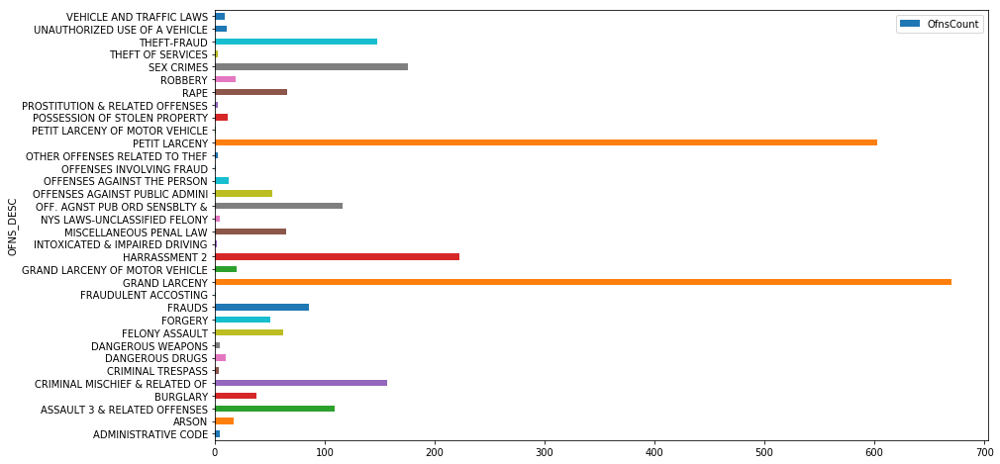

In [112]:
ny_ofnstype_data.plot(x='OFNS_DESC', y='OfnsCount', kind='barh', figsize=(14, 8))

Let's Examine Top 3 Offense types (Grand Larceny, Petit Larceny, and Harrasment 2 by Boroughs)

In [72]:
Larceny_df = df_incidents.loc[df_incidents['OFNS_DESC'] == 'GRAND LARCENY']

Larceny_data = Larceny_df.groupby(['BORO_NM']).size().to_frame(name='Count').reset_index()
Larceny_data


,BORO_NM,Count
0,BRONX,88
1,BROOKLYN,209
2,MANHATTAN,212
3,QUEENS,142
4,STATEN ISLAND,19


In [73]:
Larceny_df1 = df_incidents.loc[df_incidents['OFNS_DESC'] == 'PETIT LARCENY']

Larceny_data1 = Larceny_df1.groupby(['BORO_NM']).size().to_frame(name='Count').reset_index()
Larceny_data1

,BORO_NM,Count
0,BRONX,74
1,BROOKLYN,215
2,MANHATTAN,152
3,QUEENS,137
4,STATEN ISLAND,25


In [74]:
Larceny_df2 = df_incidents.loc[df_incidents['OFNS_DESC'] == 'HARRASSMENT 2']

Larceny_data2 = Larceny_df2.groupby(['BORO_NM']).size().to_frame(name='Count').reset_index()
Larceny_data2

,BORO_NM,Count
0,BRONX,32
1,BROOKLYN,58
2,MANHATTAN,72
3,QUEENS,56
4,STATEN ISLAND,5


In [113]:
# Let's examine Toronto Crime Data
crime_df = pd.read_csv('MCI_2014_to_2018.csv')

In [114]:
crime_data = crime_df.groupby(['Neighbourhood']).size().to_frame(name='Count').reset_index()
crime_data

,Neighbourhood,Count
0,Agincourt North (129),246
1,Agincourt South-Malvern West (128),275
2,Alderwood (20),90
3,Annex (95),615
4,Banbury-Don Mills (42),196
5,Bathurst Manor (34),254
6,Bay Street Corridor (76),805
7,Bayview Village (52),143
8,Bayview Woods-Steeles (49),82
9,Bedford Park-Nortown (39),230


In [115]:
crime_data.describe()

,Count
count,141.000000
mean,250.936170
std,227.082434
min,6.000000
25%,115.000000
50%,177.000000
75%,303.000000
max,1552.000000


In [116]:
crime_data.rename(index=str, columns={'Neighbourhood':'nhood','Count':'Crime_Count'}, inplace=True)
crime_data

,nhood,Crime_Count
0,Agincourt North (129),246
1,Agincourt South-Malvern West (128),275
2,Alderwood (20),90
3,Annex (95),615
4,Banbury-Don Mills (42),196
5,Bathurst Manor (34),254
6,Bay Street Corridor (76),805
7,Bayview Village (52),143
8,Bayview Woods-Steeles (49),82
9,Bedford Park-Nortown (39),230


In [117]:
crimetype_data = crime_df.groupby(['offence']).size().to_frame(name='Count').reset_index()
crimetype_data

,offence,Count
0,Administering Noxious Thing,48
1,Aggravated Aslt Peace Officer,1
2,Aggravated Assault,273
3,Aggravated Assault Avails Pros,2
4,Air Gun Or Pistol: Bodily Harm,2
5,Assault,12701
6,Assault - Force/Thrt/Impede,34
7,Assault - Resist/ Prevent Seiz,382
8,Assault Bodily Harm,835
9,Assault Peace Officer,713


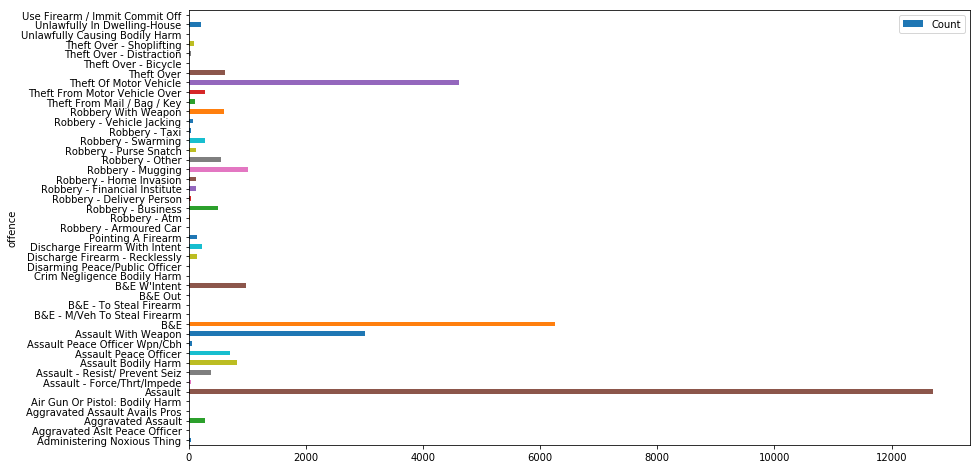

In [118]:
crimetype_data.plot(x='offence', y='Count', kind='barh', figsize=(14, 8))

In [119]:
assault_df = crime_df.loc[crime_df['offence'] == 'Assault']
assault_df

,Longitude,Latitude,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,reportedyear,reportedmonth,reportedday,reporteddayofyear,reporteddayofweek,reportedhour,occurrenceyear,occurrencemonth,occurrenceday,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Lat,Long,ObjectId
1233,-79.509682,43.739674,18109,GO-20181577456,2018-08-26T11:50:00.000Z,2018-08-26T11:58:00.000Z,Apartment,1430,100,Assault,2018,August,26,238,Sunday,11,2018,August,26,238,Sunday,11,Assault,D31,25,Glenfield-Jane Heights (25),43.739674,-79.509682,16408
2716,-79.466927,43.768856,22685,GO-2018654,2018-05-09T18:55:00.000Z,2018-05-11T13:15:00.000Z,Other,1430,100,Assault,2018,May,11,131,Friday,13,2018,May,9,129,Wednesday,18,Assault,D32,34,Bathurst Manor (34),43.768856,-79.466927,20398
4199,-79.446465,43.666729,33058,GO-20182246366,2018-12-07T09:50:00.000Z,2018-12-07T10:38:00.000Z,Outside,1430,100,Assault,2018,December,7,341,Friday,10,2018,December,7,341,Friday,9,Assault,D11,93,Dovercourt-Wallace Emerson-Junction (93),43.666729,-79.446465,30192
4362,-79.416321,43.768524,77600,GO-2018184996,2018-01-27T00:01:00.000Z,2018-01-30T02:31:00.000Z,Apartment,1430,100,Assault,2018,January,30,30,Tuesday,2,2018,January,27,27,Saturday,0,Assault,D32,37,Willowdale West (37),43.768524,-79.416321,71061
4363,-79.523438,43.644649,77622,GO-201811826,2018-01-03T01:40:00.000Z,2018-01-03T01:40:00.000Z,Apartment,1430,100,Assault,2018,January,3,3,Wednesday,1,2018,January,3,3,Wednesday,1,Assault,D22,14,Islington-City Centre West (14),43.644649,-79.523438,71080
4364,-79.295052,43.774239,77623,GO-201812218,2018-01-03T03:20:00.000Z,2018-01-03T03:27:00.000Z,Outside,1430,100,Assault,2018,January,3,3,Wednesday,3,2018,January,3,3,Wednesday,3,Assault,D42,118,Tam O'Shanter-Sullivan (118),43.774239,-79.295052,71081
4366,-79.499046,43.767540,77120,GO-201888941,2018-01-15T10:12:00.000Z,2018-01-15T10:15:00.000Z,Apartment,1430,100,Assault,2018,January,15,15,Monday,10,2018,January,15,15,Monday,10,Assault,D31,27,York University Heights (27),43.767540,-79.499046,71109
4367,-79.398644,43.654404,76916,GO-201838771,2018-01-07T13:15:00.000Z,2018-01-07T14:00:00.000Z,Outside,1430,100,Assault,2018,January,7,7,Sunday,14,2018,January,7,7,Sunday,13,Assault,D52,78,Kensington-Chinatown (78),43.654404,-79.398644,71112
4368,-79.337654,43.681248,77765,GO-2018142063,2018-01-20T16:00:00.000Z,2018-01-23T11:59:00.000Z,Other,1430,100,Assault,2018,January,23,23,Tuesday,11,2018,January,20,20,Saturday,16,Assault,D54,66,Danforth (66),43.681248,-79.337654,71124
4369,-79.442123,43.791706,77657,GO-201884645,2018-01-12T20:30:00.000Z,2018-01-14T14:00:00.000Z,Apartment,1430,100,Assault,2018,January,14,14,Sunday,14,2018,January,12,12,Friday,20,Assault,D32,36,Newtonbrook West (36),43.791706,-79.442123,71126


In [122]:
assault_data = assault_df.groupby(['Neighbourhood']).size().to_frame(name='Count').reset_index()
assault_data

,Neighbourhood,Count
0,Agincourt North (129),59
1,Agincourt South-Malvern West (128),68
2,Alderwood (20),23
3,Annex (95),205
4,Banbury-Don Mills (42),58
5,Bathurst Manor (34),75
6,Bay Street Corridor (76),326
7,Bayview Village (52),51
8,Bayview Woods-Steeles (49),28
9,Bedford Park-Nortown (39),34


In [123]:
assault_data.describe()

,Count
count,141.000000
mean,90.078014
std,87.529103
min,2.000000
25%,37.000000
50%,63.000000
75%,105.000000
max,621.000000


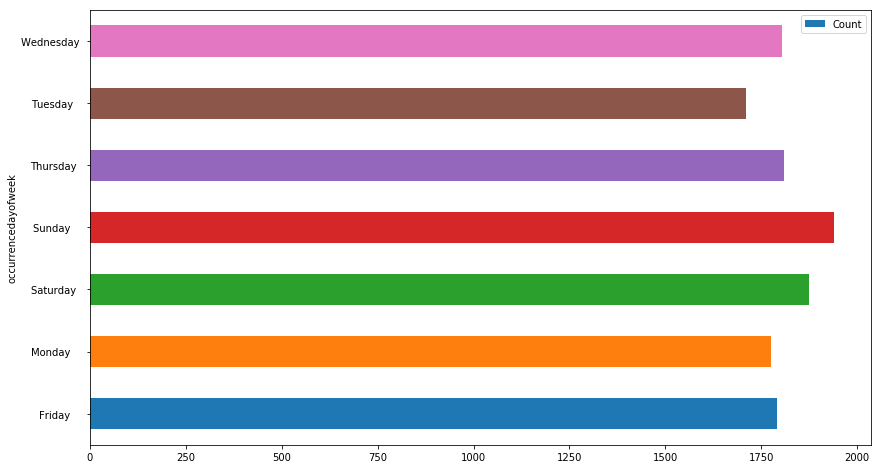

In [129]:
assault_data1 = assault_df.groupby(['occurrencedayofweek']).size().to_frame(name='Count').reset_index()
assault_data1.plot(x='occurrencedayofweek', y='Count', kind='barh', figsize=(14, 8))

## Results and Discussion <a name="results"></a>

#### Battle of Neighbourhoods:

New York is geographically a larger city with an area on 783.8 Square KMs compared to Toronto City with an area of 630.2 Square KMs. New York city is divided into 5 Boroughs containing 306 Neighbourhoods in total compared to Toronto's 103 Neighbourhoods in 10 Boroughs.

Analysis of top venues using Foursquare API is limited to Manahattan Borough in NYC and Neighbourhoods with "Toronto" in their names for Toronto City. Looking at 20 venues within a radius of 500 meters from the centre of each neighbourhood Manhattan has 203 unique venue categories.

Cluster analysis indicate that there are specific clusters in both Manahattan and Toronto with an eating place (restaurants/Cafes/Pub-Bar-Lounges) as the top two most common venues in them, and both the cities have clusters without any eating place at all. Parks, Theaters, Galleries are the common venues in the clusters without any eating places within them.

The table below provides a percentage of how many eating places are found in each of the clusters in the two cities.

| Borough      | Cluster 0| Cluster 1| Cluster 2| Cluster 3| Cluster 4|
| ------------ |:--------:|:--------:|:---------|:--------:| --------:|
| Manhattan    | 67%| 71% | 67% | 0% |73% |
| Toronto      | 81% |0%    | 0%     | 0% | 56%|

A potential restuarateur or any chef, investor etc looking to setup a restuarant in one of the two cities might start with further exploring neighbourhoods like **Lincoln Square** or **Clinton** in Cluster 3 of Manhattan and neighbourhoods like **Lawrence Park, Summerhill East, Rosedale** and **Roselawn** in Clusters 1,2,3 in toronto.

### Crime in NYC and Toronto

Based on the available **Larceny (Grand and Petit), Harrasment 2** are top 3 frequently reported crimes in New York City, while **Assault, Breaking & Entering, and Motor Vehicle Theft** are the most commonly reported crime in Toronto city.
The borough of **Brooklyn** had the highest number of Larceny reported at 424 (more than one incident a day), followed by **Manahattan** that had 364 incidents reported.

Day of the week distribution of Assault in Toronto shows the number of assaults on **Sunday** is the most followed by **Saturday** and **Wednesday**

## Conclusion <a name="conclusion"></a>

The objective of the project was to look at venues in the cities of New York and Toronto, the data suggest that the two cities are not only similar to each other in some aspects but also are different to each other in certain aspects. Both the cities have neighbourhoods which have Theaters, Parks, and Other public places as the most common venues. Certain neighbourhoods in both the cities cater to specific cuisine. E.g. Mexican Restaurant is the most frequently found venue in East Harlem, Manhattan. While Breakfast Spots are the most common venue in Parkdale Toronto. We also found that Cluster 3 in Manhattan and Clusters 1, 2, and 3 in Toronto might be the places one can explore to set up a restaurant or a cafe.

Larceny and Harrasment are the frequenlty reported crime in New York city whereas Assault, B&E, and MV Theft are the most commonly reported incidents in Toronto City.

Further data and analysis is required to explore the relationship between the type of Venues and the demographics of any particular neighbourhood in both cities and also the relationship between Crime frequency, nature etc to the demographics of a particular location in the two cities. Reverse geocoding is another step that we would like to explore visualizing crimes on an interactive map using Nominatim package.

